Import des dépendances principales panda, seaborn et matplotlib

In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt

1. créer une variable mydata à partir de la lecture du fichier csv avec
pd.read_csv('wine-quality-white-and-red.csv')
2. réaliser une copie de "mydata" en "df"

In [2]:
mydata=pd.read_csv('wine-quality-white-and-red.csv')
df=mydata.copy()
print(df.head(5))

    type  fixed acidity  volatile acidity  citric acid  residual sugar  \
0  white            7.0              0.27         0.36            20.7   
1  white            6.3              0.30         0.34             1.6   
2  white            8.1              0.28         0.40             6.9   
3  white            7.2              0.23         0.32             8.5   
4  white            7.2              0.23         0.32             8.5   

   chlorides  free sulfur dioxide  total sulfur dioxide  density    pH  \
0      0.045                 45.0                 170.0   1.0010  3.00   
1      0.049                 14.0                 132.0   0.9940  3.30   
2      0.050                 30.0                  97.0   0.9951  3.26   
3      0.058                 47.0                 186.0   0.9956  3.19   
4      0.058                 47.0                 186.0   0.9956  3.19   

   sulphates  alcohol  quality  
0       0.45      8.8        6  
1       0.49      9.5        6  
2       0.4

4. Afficher une colonne particulière du jeu de données

In [3]:
colonne_acidity=df["fixed acidity"]
print(colonne_acidity)

0       7.0
1       6.3
2       8.1
3       7.2
4       7.2
       ... 
6492    6.2
6493    5.9
6494    6.3
6495    5.9
6496    6.0
Name: fixed acidity, Length: 6497, dtype: float64


5. Afficher une valeur particulière

In [4]:
valeur_4_5 = df.iloc[4,5]
print(valeur_4_5)

0.058


Afficher uniquement les vins de type "rouge" puis "blancs"

In [5]:
vins_rouges=df[df["type"] == "red"]
print(vins_rouges)

vins_blancs=df[df["type"] == "white"]
print(vins_blancs)

     type  fixed acidity  volatile acidity  citric acid  residual sugar  \
4898  red            7.4             0.700         0.00             1.9   
4899  red            7.8             0.880         0.00             2.6   
4900  red            7.8             0.760         0.04             2.3   
4901  red           11.2             0.280         0.56             1.9   
4902  red            7.4             0.700         0.00             1.9   
...   ...            ...               ...          ...             ...   
6492  red            6.2             0.600         0.08             2.0   
6493  red            5.9             0.550         0.10             2.2   
6494  red            6.3             0.510         0.13             2.3   
6495  red            5.9             0.645         0.12             2.0   
6496  red            6.0             0.310         0.47             3.6   

      chlorides  free sulfur dioxide  total sulfur dioxide  density    pH  \
4898      0.076       

7. Citer les données catégoriques du dataset

In [6]:
categorical_columns = df.select_dtypes(include=["object", "int"]).columns.tolist()
print("Colonnes catégoriques :", categorical_columns)

Colonnes catégoriques : ['type', 'quality']


8. Décrire le dataset à partir de la fonction describe

In [7]:
print(df.describe())

       fixed acidity  volatile acidity  citric acid  residual sugar  \
count    6497.000000       6497.000000  6497.000000     6497.000000   
mean        7.215307          0.339666     0.318633        5.443235   
std         1.296434          0.164636     0.145318        4.757804   
min         3.800000          0.080000     0.000000        0.600000   
25%         6.400000          0.230000     0.250000        1.800000   
50%         7.000000          0.290000     0.310000        3.000000   
75%         7.700000          0.400000     0.390000        8.100000   
max        15.900000          1.580000     1.660000       65.800000   

         chlorides  free sulfur dioxide  total sulfur dioxide      density  \
count  6497.000000          6497.000000           6497.000000  6497.000000   
mean      0.056034            30.525319            115.744574     0.994697   
std       0.035034            17.749400             56.521855     0.002999   
min       0.009000             1.000000         

9- Analyser le dataset avec les différentes options de pairplot

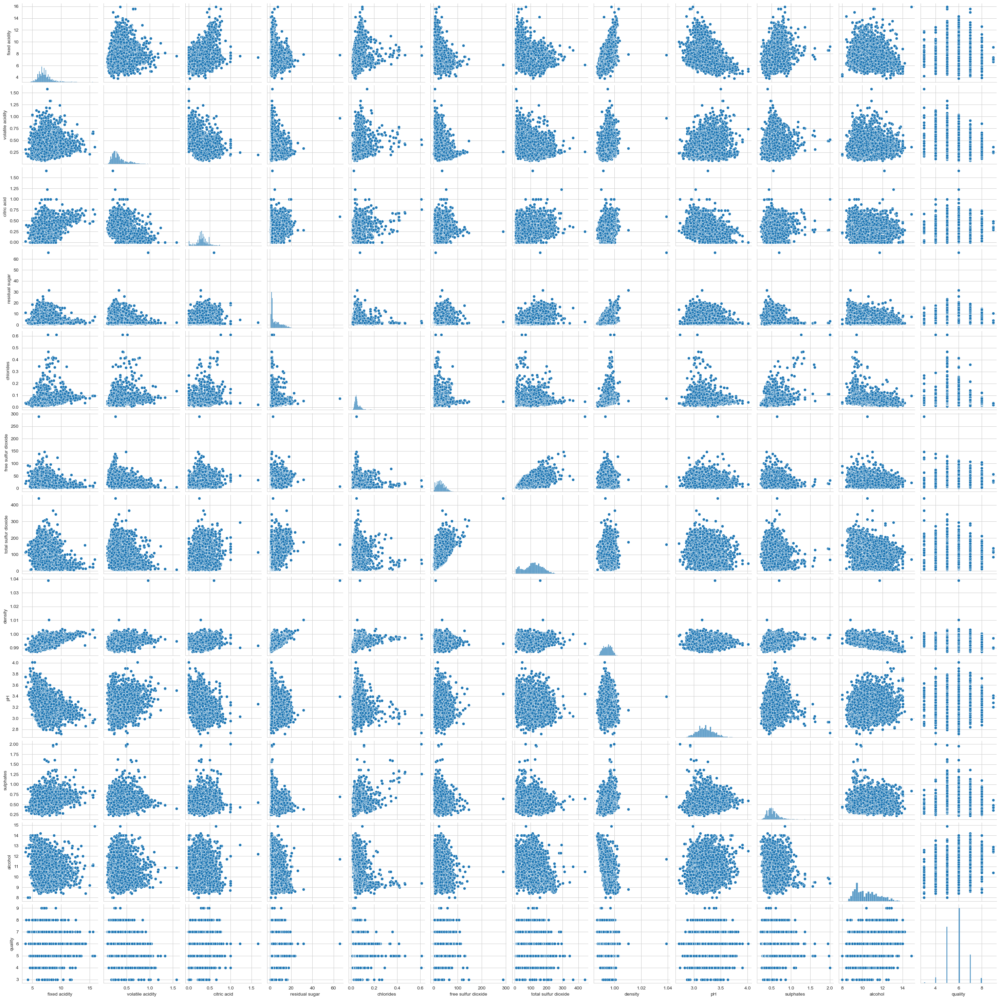

In [8]:
sns.pairplot(df)

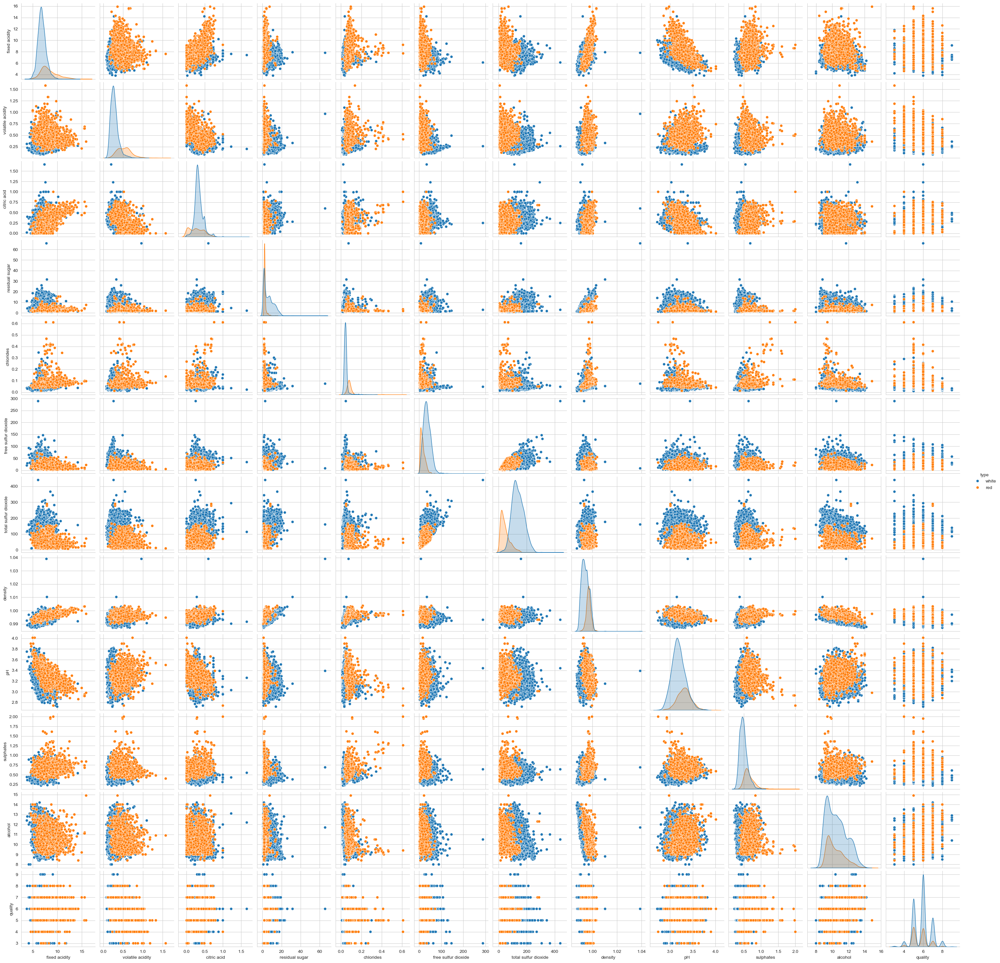

In [9]:
sns.pairplot(df, hue='type')

In [10]:
custom_palette = {3: 'blue', 4: 'green', 5: 'yellow', 6: 'red', 7: 'purple'}

sns.pairplot(df, hue='quality',height=10, palette="hls" )


10. Afficher le pH en fonction des chlorides paramétrée en fonction du niveau d'alcool (hue='alcohol')
en utilisant la fonction scatterplot


<Axes: xlabel='chlorides', ylabel='pH'>

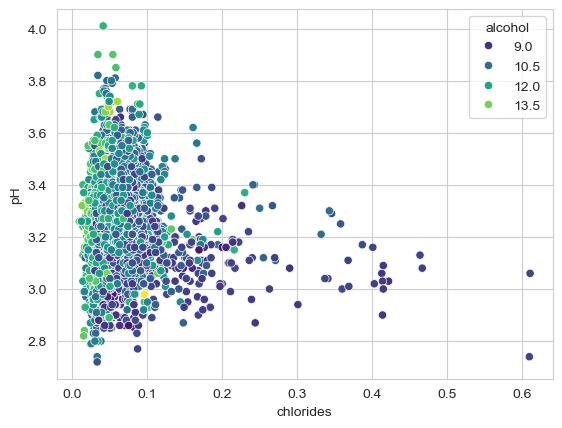

In [11]:

sns.scatterplot(data=df, x='chlorides', y='pH', hue='alcohol', palette='viridis')


### Interprétation :

Pas de corrélation linéaire évidente: Il n'y a pas de relation linéaire claire entre le pH et les chlorures. Les points sont dispersés sur tout le graphique, sans former de forme particulière (ligne, courbe).


11- Afficher la quantité de vin rouge et de vins blanc en fonction de sa qualité en utilisant countplot

<Axes: xlabel='quality', ylabel='count'>

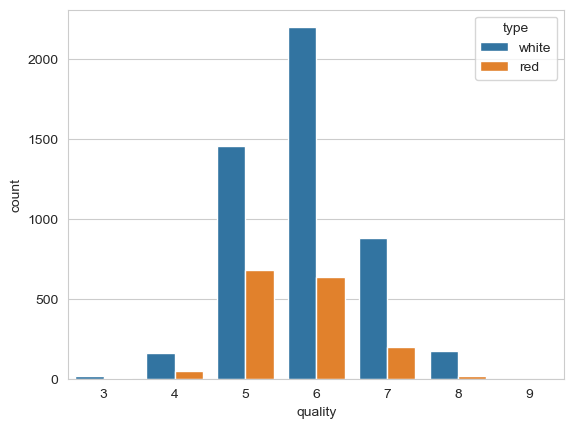

In [12]:
# Créer un countplot pour visualiser la quantité de vins blancs et rouges selon la qualité
sns.countplot(data=df, x='quality', hue='type')

### Interpretation 

- **Dominance des vins de qualité moyenne** : 
  - On observe que la majorité des vins, qu'ils soient rouges ou blancs, se situent dans les catégories de qualité 5, 6 et 7. Cela suggère que la production viticole est concentrée sur des vins de qualité moyenne.

- **Moins de vins d'excellente qualité** : 
  - Les vins de très haute qualité (note 9) sont relativement rares, tant pour les vins rouges que pour les vins blancs.

- **Différences entre les vins rouges et blancs** :
  - **Concentration autour de la note 6** : Les vins blancs semblent légèrement plus concentrés autour de la note 6, tandis que les vins rouges ont une distribution un peu plus étalée.
  - **Moins de vins blancs de très bonne qualité** : Il semble y avoir proportionnellement moins de vins blancs de très haute qualité (note 9) par rapport aux vins rouges.


12. Afficher la quantité de vin rouge et de vins blanc en fonction de sa qualité en utilisant pairplot


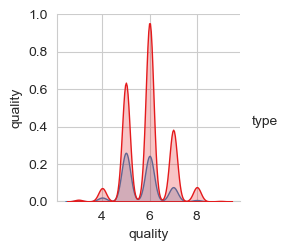

In [43]:
#
sns.pairplot(df, hue='type', vars=['quality'], palette="Set1")

Interpretation

13- Afficher la quantité de vin rouge et de vins blanc en fonction de sa qualité en utilisant barplot


<Axes: xlabel='quality'>

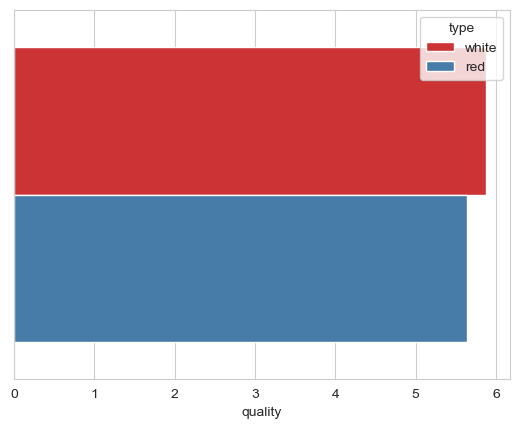

In [13]:
# Étape 2 : Créer un barplot pour afficher la quantité de vin rouge et blanc par qualité

sns.barplot(data=df, x='quality', hue='type', errorbar=None, palette="Set1")


Interpretation

14- Remplacer le type "red" par 1 et le type "blanc par "zero"

In [14]:
df2=df.copy()
df2['type'] = df2['type'].replace({"red": 1, "white": 0})
df2['type'] = df2['type'].astype(int)
print(df2)

      type  fixed acidity  volatile acidity  citric acid  residual sugar  \
0        0            7.0             0.270         0.36            20.7   
1        0            6.3             0.300         0.34             1.6   
2        0            8.1             0.280         0.40             6.9   
3        0            7.2             0.230         0.32             8.5   
4        0            7.2             0.230         0.32             8.5   
...    ...            ...               ...          ...             ...   
6492     1            6.2             0.600         0.08             2.0   
6493     1            5.9             0.550         0.10             2.2   
6494     1            6.3             0.510         0.13             2.3   
6495     1            5.9             0.645         0.12             2.0   
6496     1            6.0             0.310         0.47             3.6   

      chlorides  free sulfur dioxide  total sulfur dioxide  density    pH  \
0         

C:\Users\franc\AppData\Local\Temp\ipykernel_61872\3186976902.py:2: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df2['type'] = df2['type'].replace({"red": 1, "white": 0})


# PARTIE 2

## 1. Supprimer 10 valeurs du Fichier csv et les remplacer par NaN



In [15]:
# Supprimer 10 valeurs aléatoires et les remplacer par NaN
# On choisit 10 indices aléatoires
indices = np.random.choice(df2.size, size=10, replace=False)

# Remplacer ces indices par NaN
df2.values.ravel()[indices] = np.nan

## 2- Afficher le headmap des valeurs manquantes (sns.heatmap(df.isna().transpose(), cbar=False, ax=ax))

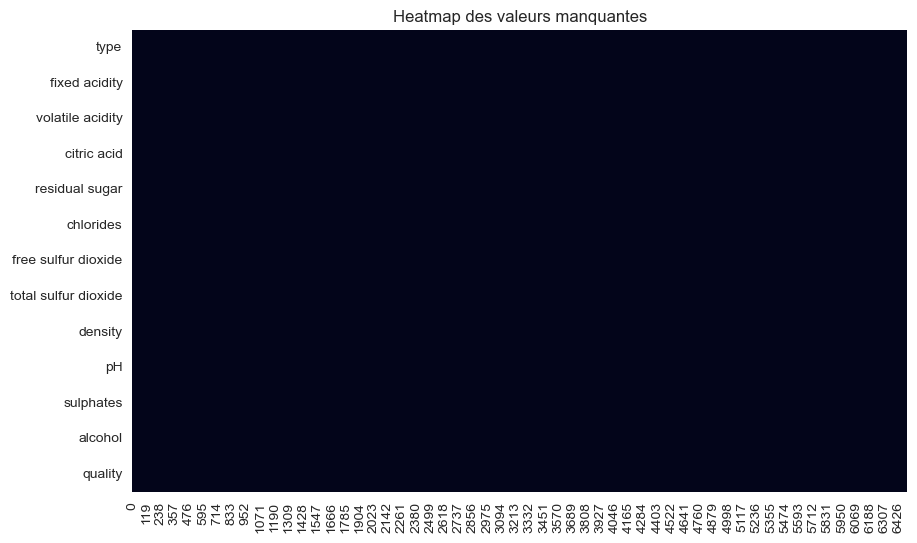

In [16]:
fig, ax=plt.subplots(figsize=(10,6))
sns.heatmap(df2.isna().transpose(), cbar=False, ax=ax)
plt.title("Heatmap des valeurs manquantes")
plt.show()

### Commentaires 

La seule valeur manquante n'impacte pas suffisament le dataframe pour être visible sur la heatmap

## 3- supprimer les lignes où il y a une valeur manquante.

In [17]:
# Supprimer les lignes contenant des valeurs manquantes (NaN)
df2_cleaned = df2.dropna()

# Afficher le DataFrame après suppression des lignes avec des NaN
print(df2_cleaned)


      type  fixed acidity  volatile acidity  citric acid  residual sugar  \
0        0            7.0             0.270         0.36            20.7   
1        0            6.3             0.300         0.34             1.6   
2        0            8.1             0.280         0.40             6.9   
3        0            7.2             0.230         0.32             8.5   
4        0            7.2             0.230         0.32             8.5   
...    ...            ...               ...          ...             ...   
6492     1            6.2             0.600         0.08             2.0   
6493     1            5.9             0.550         0.10             2.2   
6494     1            6.3             0.510         0.13             2.3   
6495     1            5.9             0.645         0.12             2.0   
6496     1            6.0             0.310         0.47             3.6   

      chlorides  free sulfur dioxide  total sulfur dioxide  density    pH  \
0         

## 4- Utiliser .drp

In [20]:
# Identifier les index des lignes contenant des valeurs manquantes
missing_indices = df[df.isnull().any(axis=1)].index

# Supprimer les lignes en utilisant drop
df = df.drop(missing_indices)

5- Remplacer les valeurs manquantes par interpolation

In [21]:
df2_interpolated = df2_cleaned.interpolate()


# PARTIE 3  Etude statistique

## 1. Calculer les moyennes et écart-type des pH des vins rouges et blancs

In [22]:
# Calculer les moyennes et écart-types
moyenne_pH_rouge = vins_rouges["pH"].mean()
ecart_type_pH_rouge = vins_rouges["pH"].std()

moyenne_pH_blanc = vins_blancs["pH"].mean()
ecart_type_pH_blanc = vins_blancs["pH"].std()

# Afficher les résultats
print(f"Moyenne pH (vin rouge) : {moyenne_pH_rouge:.2f}")
print(f"Écart-type pH (vin rouge) : {ecart_type_pH_rouge:.2f}")
print(f"Moyenne pH (vin blanc) : {moyenne_pH_blanc:.2f}")
print(f"Écart-type pH (vin blanc) : {ecart_type_pH_blanc:.2f}")

Moyenne pH (vin rouge) : 3.31
Écart-type pH (vin rouge) : 0.15
Moyenne pH (vin blanc) : 3.19
Écart-type pH (vin blanc) : 0.15


### Commentaires

- **Moyenne pH (vin rouge)** : 3.31
  - Le pH moyen des vins rouges est légèrement plus élevé que celui des vins blancs, ce qui suggère que les vins rouges tendent à être un peu moins acides que les vins blancs.
  
- **Écart-type pH (vin rouge)** : 0.15
  - L'écart-type relativement faible indique que la majorité des vins rouges ont un pH assez proche de la moyenne, avec peu de variation.

- **Moyenne pH (vin blanc)** : 3.19
  - Le pH moyen des vins blancs est légèrement plus faible que celui des vins rouges, ce qui reflète généralement une acidité plus marquée dans les vins blancs.

- **Écart-type pH (vin blanc)** : 0.15
  - Comme pour les vins rouges, l'écart-type des vins blancs est également faible, ce qui signifie que la majorité des vins blancs ont un pH proche de la moyenne.


## 2. Afficher le diagramme pour le pH des vins rouges

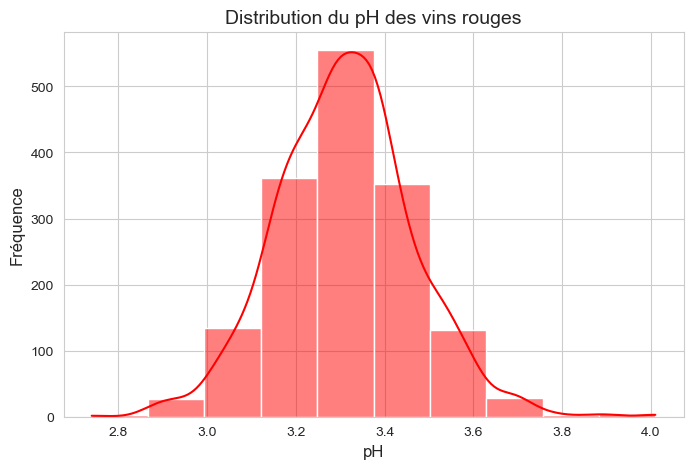

In [23]:
# Créer un histogramme pour le pH des vins rouges
plt.figure(figsize=(8, 5))
sns.histplot(vins_rouges["pH"], kde=True, color="red", bins=10)
plt.title("Distribution du pH des vins rouges", fontsize=14)
plt.xlabel("pH", fontsize=12)
plt.ylabel("Fréquence", fontsize=12)
plt.show()

### Commentaires

#### Forme de la distribution :
- **Asymétrie positive** : La distribution est légèrement asymétrique positive, ce qui signifie qu'il y a une plus grande concentration de valeurs de pH faibles (acides) par rapport aux valeurs élevées (basiques). La queue de la distribution est plus longue vers les valeurs élevées de pH.
- **Modalité** : La distribution est unimodale, c'est-à-dire qu'elle présente un seul pic. Cela indique qu'il existe une valeur centrale autour de laquelle se concentrent la plupart des vins rouges en termes de pH. Il se situe autour de 3.2, ce qui suggère que la majorité des vins rouges ont un pH proche de 3.3

## 3. Afficher le diagramme pour le pH des vins blancs

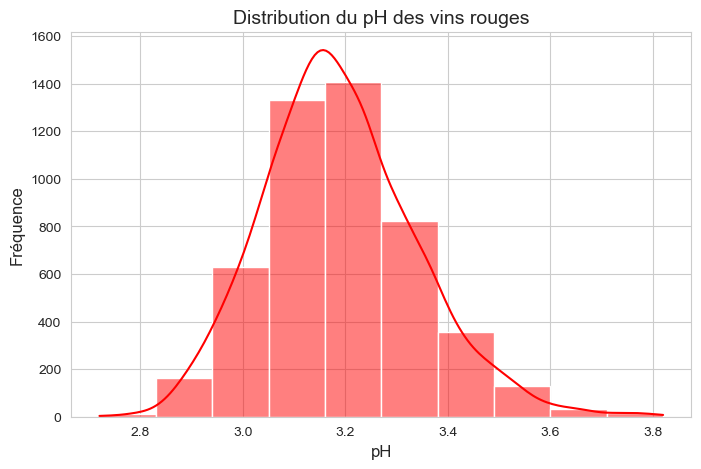

In [24]:
# Créer un histogramme pour le pH des vins rouges
plt.figure(figsize=(8, 5))
sns.histplot(vins_blancs["pH"], kde=True, color="red", bins=10)
plt.title("Distribution du pH des vins blancs", fontsize=14)
plt.xlabel("pH", fontsize=12)
plt.ylabel("Fréquence", fontsize=12)
plt.show()

### Commentaires


#### Forme de la distribution :
- **Asymétrie positive** : La distribution est légèrement asymétrique positive, ce qui signifie qu'il y a une plus grande concentration de valeurs de pH faibles (acides) par rapport aux valeurs élevées (basiques). La queue de la distribution est plus longue vers les valeurs élevées de pH.
- **Modalité** : La distribution est unimodale, c'est-à-dire qu'elle présente un seul pic. Cela indique qu'il existe une valeur centrale autour de laquelle se concentrent la plupart des vins rouges en termes de pH. Il se situe autour de 3.2, ce qui suggère que la majorité des vins rouges ont un pH proche de 3.2.


## 4. Afficher l'histogramme de toutes les variables

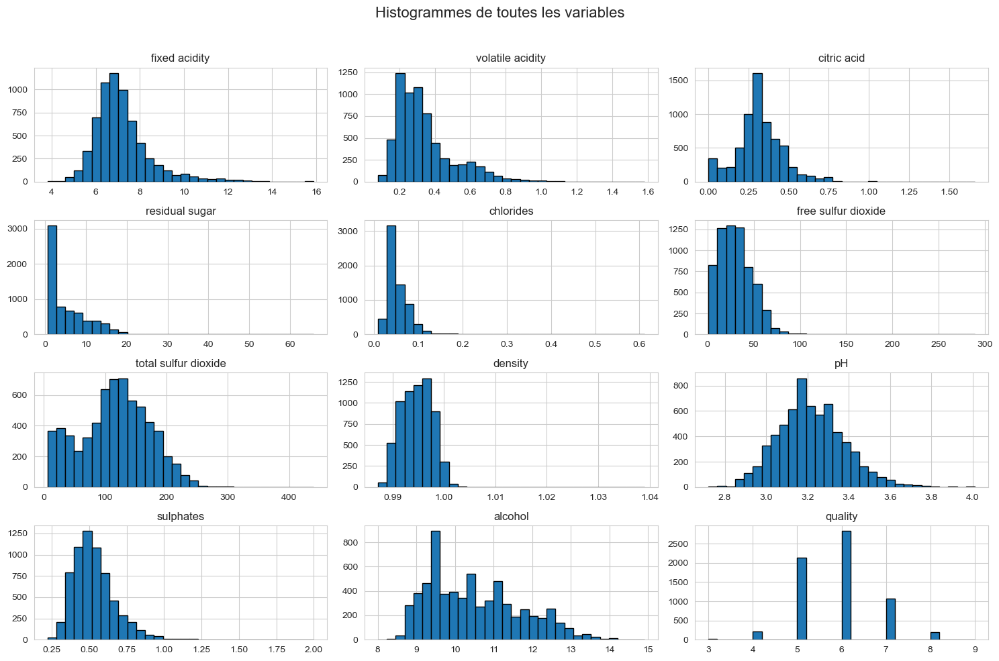

In [25]:
# Afficher l'histogramme de toutes les variables
df.hist(bins=30, figsize=(15, 10), edgecolor='black')
plt.suptitle('Histogrammes de toutes les variables', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96])  # Ajuster pour le titre
plt.show()

### Commentaires 

#### Formes variées: 
Certaines caractéristiques ont une répartition assez régulière (par exemple, le pH), tandis que d'autres sont plus concentrées sur certaines valeurs (comme le sucre résiduel).
#### Valeurs extrêmes: 
On remarque parfois des valeurs très élevées ou très faibles par rapport au reste des données (par exemple, pour les chlorures).
#### Groupes de vins: 
Pour certaines caractéristiques, on peut observer des groupes de vins ayant des valeurs similaires.

## 5- Comparer la répartition des données en utilisant les boîtes à moustaches

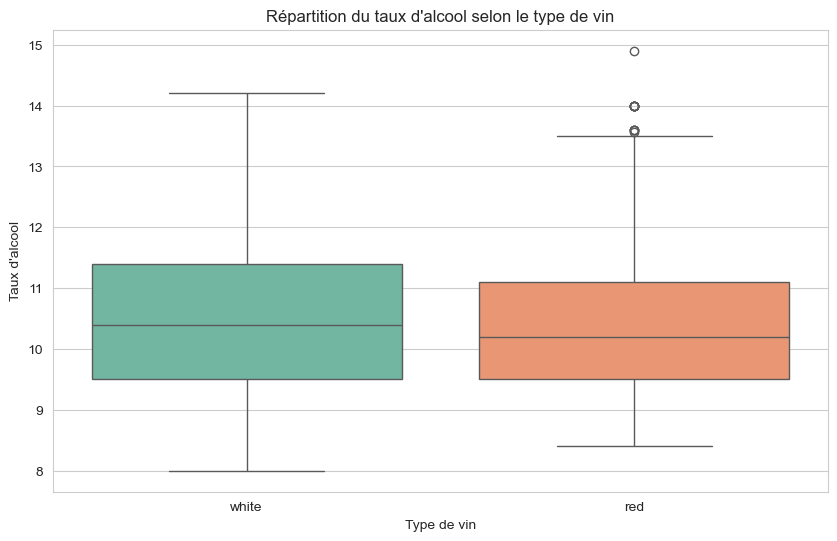

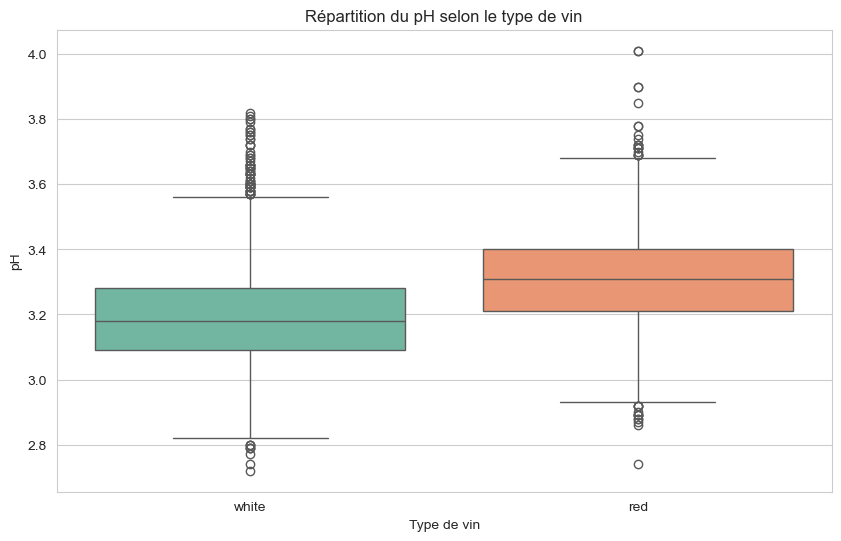

In [30]:
import seaborn as sns
import matplotlib.pyplot as plt

# Boîtes à moustaches pour comparer 'alcohol' selon le type de vin
plt.figure(figsize=(10, 6))
sns.boxplot(data=df, y="alcohol", x="type", hue="type", palette="Set2", dodge=False)
plt.title("Répartition du taux d'alcool selon le type de vin")
plt.xlabel("Type de vin")
plt.ylabel("Taux d'alcool")
plt.legend([], [], frameon=False)  # Supprimer la légende si non nécessaire
plt.show()

# Boîtes à moustaches pour comparer 'pH' selon le type de vin
plt.figure(figsize=(10, 6))
sns.boxplot(data=df, y="pH", x="type", hue="type", palette="Set2", dodge=False)
plt.title("Répartition du pH selon le type de vin")
plt.xlabel("Type de vin")
plt.ylabel("pH")
plt.legend([], [], frameon=False)  # Supprimer la légende si non nécessaire
plt.show()


## 6- Comment se lisent ces graphiques ? Que nous disent-ils ? 

#### PH
###### Médiane:
 Le pH médian des vins blancs est inférieur à celui des vins rouges. Cela suggère que, en moyenne, les vins blancs sont plus acides que les vins rouges.
###### Écart interquartile:
 L'écart entre le premier et le troisième quartile est plus important pour les vins rouges, ce qui indique une plus grande dispersion des valeurs de pH dans cette catégorie.
###### Valeurs extrêmes: 
On observe quelques valeurs extrêmes (outliers) pour les deux types de vin, particulièrement pour les vins rouges. Ces valeurs pourraient correspondre à des vins spécifiques ou à des erreurs de mesure.
###### Asymétrie: 
La boîte des vins rouges semble légèrement plus large en partie haute, suggérant une légère asymétrie positive de la distribution (une queue plus longue vers les valeurs élevées).

#### Alcool
###### Médiane: 
Le taux d'alcool médian des vins rouges semble légèrement supérieur à celui des vins blancs. Cela suggère qu'en moyenne, les vins rouges ont un degré d'alcool plus élevé.
###### Écart interquartile:
 L'écart entre le premier et le troisième quartile est similaire pour les deux types de vin, indiquant une dispersion des valeurs relativement comparable.
###### Valeurs extrêmes: 
On observe quelques valeurs extrêmes (outliers) pour les vins rouges, notamment des taux d'alcool particulièrement élevés. Ces valeurs pourraient correspondre à des vins doux, des vins fortifiés ou à des erreurs de mesure.
###### Asymétrie: 
Les boîtes des deux catégories semblent relativement symétriques, suggérant des distributions assez proches de la normale.

## 7- Calculer les quartiles et la médiane du taux d'alcool, commenter :

In [31]:
# Quartiles et médiane pour le taux d'alcool
red_wine_alcohol = df[df['type'] == 'red']['alcohol']
white_wine_alcohol = df[df['type'] == 'white']['alcohol']

red_quartiles = red_wine_alcohol.quantile([0.25, 0.5, 0.75])
white_quartiles = white_wine_alcohol.quantile([0.25, 0.5, 0.75])

print("Vins rouges - Quartiles :\n", red_quartiles)
print("Vins blancs - Quartiles :\n", white_quartiles)


Vins rouges - Quartiles :
 0.25     9.5
0.50    10.2
0.75    11.1
Name: alcohol, dtype: float64
Vins blancs - Quartiles :
 0.25     9.5
0.50    10.4
0.75    11.4
Name: alcohol, dtype: float64


### Commentaires

Les résultats montrent que :

#### Médiane: 
Le taux d'alcool médian des vins rouges est légèrement supérieur à celui des vins blancs (10.2% vs 10.4%).
#### Écart interquartile: 
L'écart interquartile est similaire pour les deux types de vin, suggérant une dispersion des valeurs relativement comparable.
#### Distribution: 
Les distributions des taux d'alcool semblent assez similaires entre les vins rouges et blancs, avec une légère tendance à des taux d'alcool plus élevés pour les vins rouges.

## 8. Quel est le poids des groupes ?

In [35]:
# Poids des groupes
red_count = len(df[df['type'] == 'red'])
white_count = len(df[df['type'] == 'white'])

total_count = len(df)
red_weight = red_count / total_count * 100
white_weight = white_count / total_count * 100

print(f"Poids des vins rouges : {red_weight:.2f}%")
print(f"Poids des vins blancs : {white_weight:.2f}%")


Poids des vins rouges : 24.61%
Poids des vins blancs : 75.39%


### Interpretation

Les résultats indiquent que :
75,39% des vins dans l'ensemble de données sont des vins blancs.
24,61% des vins dans l'ensemble de données sont des vins rouges.

## 9. Moyenne et écart type pour chaque groupe


In [37]:
# Moyenne et écart type pour les vins rouges
red_wine_mean = df[df["type"] == "red"]["alcohol"].mean()
red_wine_std = df[df["type"] == "red"]["alcohol"].std()

# Moyenne et écart type pour les vins blancs
white_wine_mean = df[df["type"] == "white"]["alcohol"].mean()
white_wine_std = df[df["type"] == "white"]["alcohol"].std()

print(f"Moyenne du taux d'alcool dans les vins rouges : {red_wine_mean:.2f}")
print(f"Écart type du taux d'alcool dans les vins rouges : {red_wine_std:.2f}")

print(f"Moyenne du taux d'alcool dans les vins blancs : {white_wine_mean:.2f}")
print(f"Écart type du taux d'alcool dans les vins blancs : {white_wine_std:.2f}")


Moyenne du taux d'alcool dans les vins rouges : 10.42
Écart type du taux d'alcool dans les vins rouges : 1.07
Moyenne du taux d'alcool dans les vins blancs : 10.51
Écart type du taux d'alcool dans les vins blancs : 1.23


## 10. en utilisant .describe

In [38]:
# Résumé statistique pour les vins rouges et blancs
red_wine_stats = df[df["type"] == "red"]["alcohol"].describe()
white_wine_stats = df[df["type"] == "white"]["alcohol"].describe()

print("\nStatistiques descriptives pour les vins rouges :")
print(red_wine_stats)

print("\nStatistiques descriptives pour les vins blancs :")
print(white_wine_stats)



Statistiques descriptives pour les vins rouges :
count    1599.000000
mean       10.422983
std         1.065668
min         8.400000
25%         9.500000
50%        10.200000
75%        11.100000
max        14.900000
Name: alcohol, dtype: float64

Statistiques descriptives pour les vins blancs :
count    4898.000000
mean       10.514267
std         1.230621
min         8.000000
25%         9.500000
50%        10.400000
75%        11.400000
max        14.200000
Name: alcohol, dtype: float64


## Comparaison
### Les résultats obtenus sont les mêmes que les précédents

## 11 - # Calculer et afficher la matrice de corrélation


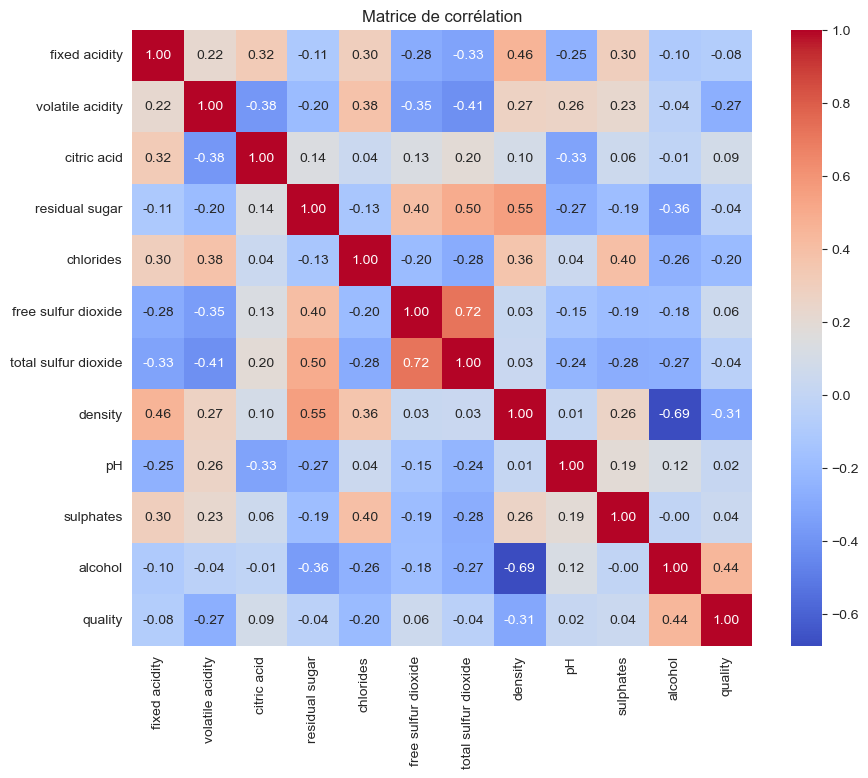

In [40]:
# Sélectionner uniquement les colonnes numériques
numeric_df = df.select_dtypes(include=[np.number])

# Calculer et afficher la matrice de corrélation
correlation_matrix = numeric_df.corr()

plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Matrice de corrélation")
plt.show()


### Interprétation des résultats

En observant la matrice de corrélation fournie, nous pouvons tirer plusieurs conclusions :

#### Corrélations positives fortes :
- **Densité et alcool** : Une forte corrélation positive indique que plus le vin est dense, plus son taux d'alcool est élevé. Cela est cohérent avec la composition du vin.
- **Sulfates et alcool** : Une corrélation positive modérée suggère que les sulfates pourraient être liés à un taux d'alcool plus élevé, bien que la relation soit moins forte que celle entre la densité et l'alcool.
- **Sucres résiduels et densité** : Une corrélation positive indique que plus le vin contient de sucres résiduels, plus sa densité est élevée.

#### Corrélations négatives fortes :
- **Volatile acidity et qualité** : Une forte corrélation négative suggère que plus le niveau d'acidité volatile est élevé, moins le vin est de bonne qualité. L'acidité volatile est souvent associée à des défauts dans le vin.
- **Volatile acidity et pH** : Une corrélation négative montre que l'acidité volatile diminue lorsque le pH augmente.

#### Autres corrélations notables :
- **Acides fixes et densité** : Une corrélation positive modérée.
- **Dioxyde de soufre libre et total** : Une très forte corrélation positive, ce qui est attendu car le dioxyde de soufre total inclut le dioxyde de soufre libre.

#### Corrélations faibles ou nulles :
De nombreuses paires de variables présentent une corrélation faible ou nulle, ce qui signifie qu'il n'y a pas de relation linéaire significative entre elles.


# 4. Prétraitement élémentaire

## On va faire de l'oversampling et de l'undersampling car les poids sont déséquilibrés ( + de vins rouges que blanc)

SMOTE est utilisé pour augmenter la classe minoritaire (les vins rouges), ce qui crée de nouvelles observations synthétiques.


RandomUnderSampler est utilisé pour réduire la classe majoritaire (les vins blancs), ce qui supprime certaines observations afin d'équilibrer les classes.

In [41]:
import pandas as pd
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler

# Séparation des caractéristiques et de la cible
X = df.drop(columns='type')
y = df['type']

# 1. Oversampling avec SMOTE
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_resampled, y_resampled = smote.fit_resample(X, y)
print("Après l'oversampling avec SMOTE :")
print("Poids des vins rouges : {:.2f}%".format((y_resampled.value_counts(normalize=True)['red'] * 100)))
print("Poids des vins blancs : {:.2f}%".format((y_resampled.value_counts(normalize=True)['white'] * 100)))

# 2. Undersampling avec RandomUnderSampler
undersample = RandomUnderSampler(sampling_strategy='auto', random_state=42)
X_resampled_undersample, y_resampled_undersample = undersample.fit_resample(X, y)
print("Après l'undersampling avec RandomUnderSampler :")
print("Poids des vins rouges : {:.2f}%".format((y_resampled_undersample.value_counts(normalize=True)['red'] * 100)))
print("Poids des vins blancs : {:.2f}%".format((y_resampled_undersample.value_counts(normalize=True)['white'] * 100)))


Après l'oversampling avec SMOTE :
Poids des vins rouges : 50.00%
Poids des vins blancs : 50.00%
Après l'undersampling avec RandomUnderSampler :
Poids des vins rouges : 50.00%
Poids des vins blancs : 50.00%


## Nous allons appliquer à la fois StandardScaler et MinMaxScaler pour normaliser les données puis comparer.

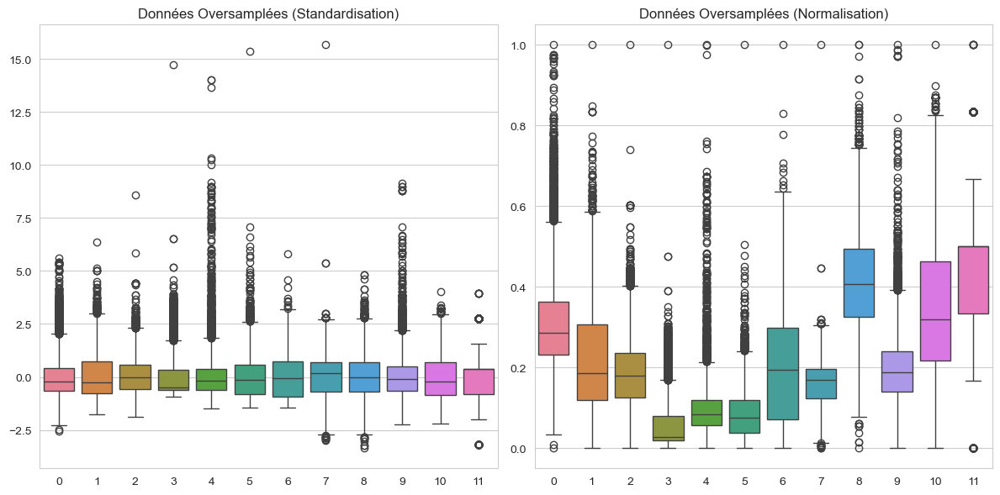

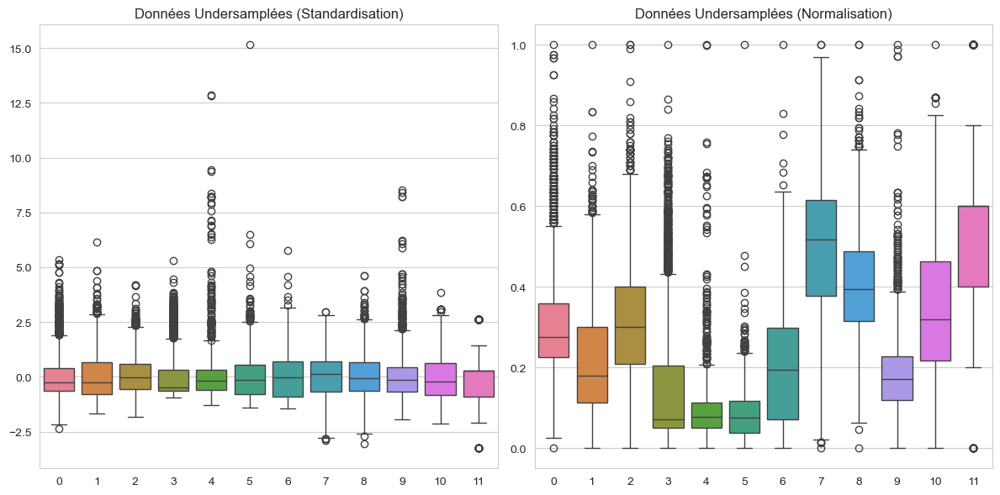

In [42]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler

# 3. Standardisation des données : StandardScaler
scaler = StandardScaler()

# Appliquer la standardisation aux données oversamplées
X_resampled_scaled = scaler.fit_transform(X_resampled)

# Appliquer la standardisation aux données undersamplées
X_resampled_undersample_scaled = scaler.fit_transform(X_resampled_undersample)

# 4. Normalisation des données : MinMaxScaler
scaler_minmax = MinMaxScaler()

# Appliquer la normalisation aux données oversamplées
X_resampled_normalized = scaler_minmax.fit_transform(X_resampled)

# Appliquer la normalisation aux données undersamplées
X_resampled_undersample_normalized = scaler_minmax.fit_transform(X_resampled_undersample)

# Comparaison des résultats avec des graphiques
# Boîtes à moustaches pour comparer les valeurs après normalisation et standardisation
plt.figure(figsize=(12, 6))

# Comparer les données après standardisation (oversampling)
plt.subplot(1, 2, 1)
sns.boxplot(data=X_resampled_scaled)
plt.title('Données Oversamplées (Standardisation)')

# Comparer les données après normalisation (oversampling)
plt.subplot(1, 2, 2)
sns.boxplot(data=X_resampled_normalized)
plt.title('Données Oversamplées (Normalisation)')

plt.tight_layout()
plt.show()

# Boîtes à moustaches pour comparer les valeurs après normalisation et standardisation
plt.figure(figsize=(12, 6))

# Comparer les données après standardisation (undersampling)
plt.subplot(1, 2, 1)
sns.boxplot(data=X_resampled_undersample_scaled)
plt.title('Données Undersamplées (Standardisation)')

# Comparer les données après normalisation (undersampling)
plt.subplot(1, 2, 2)
sns.boxplot(data=X_resampled_undersample_normalized)
plt.title('Données Undersamplées (Normalisation)')

plt.tight_layout()
plt.show()

## Analyse de l'impact de la standardisation et de la normalisation

Données standardisées : Les données sont centrées autour de 0 et ont des écarts types différents selon les variables. Les outliers sont toujours présents, mais leur influence est réduite. Cela permet de mieux comparer les variables qui avaient des échelles différentes.

Données normalisées : Toutes les valeurs sont comprises entre 0 et 1. Les outliers sont toujours là, mais leur impact est limité. Cette méthode met l'accent sur l'ordre des valeurs et permet aussi une bonne comparaison entre les variables.

Différence oversampling/undersampling : 